# Video-To-Video Pipeline


### Save Intermediate Checkpoint


In [ ]:
# intermediate save
import torch
from diffusers import StableDiffusionPipeline, UNet2DConditionModel

model_path = "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/sd"
unet_path = "/data/noah/ckpt/finetuning/SD_AD/checkpoint-20000"
out_path = "/data/noah/ckpt/finetuning/SD_AD"

pipeline = StableDiffusionPipeline.from_pretrained(model_path, torch_dtype=torch.float16).to("cuda:2")

pipeline.unet = UNet2DConditionModel.from_pretrained(
    unet_path,
    subfolder="unet",
    revision=None,
)

pipeline.save_pretrained(out_path)

### Stable Diffusion Image-to-Image Pipeline


In [ ]:
import cv2
import torch
from diffusers import StableDiffusionImg2ImgPipeline
from diffusers.utils import export_to_gif
import imageio
from PIL import Image as PILImage
from IPython.display import display, Image
from controlnet_aux import CannyDetector

device = "cuda:2"
torch.cuda.set_device(device)

# Load the motion adapter
model_id = "/data/noah/ckpt/finetuning/SD_AD"
pipe = StableDiffusionImg2ImgPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe.enable_freeu(s1=1.5, s2=0.7, b1=1.5, b2=1.7)
pipe = pipe.to(device)

image_path = "/data/noah/inference/_simulation/2.png"

from diffusers.utils import load_image

image = load_image(image_path).convert("RGB")

prompt = "cars are driving on the road, outdoor, best quality, extremely detailed, clearness, naturalness, film grain, crystal clear, photo with color, actuality"
negative_prompt = "cartoon, anime, painting, disfigured, immature, blur, picture, 3D, render, semi-realistic, drawing, poorly drawn, bad anatomy, wrong anatomy, gray scale, worst quality, low quality, sketch"

result_image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    image=image,
    height=512,  # 512
    width=768,  # 768
    guidance_scale=7.0,  # 7
    strength=0.5,
    num_inference_steps=40,  # 20
    generator=torch.Generator().manual_seed(42),
).images[0]

new_w, new_h = image.width, image.height
result_image = result_image.resize((new_w, new_h))
display(result_image)

### Animate Diff Viedeo-to-Video Pipeline


The config attributes {'motion_activation_fn': 'geglu', 'motion_attention_bias': False, 'motion_cross_attention_dim': None} were passed to MotionAdapter, but are not expected and will be ignored. Please verify your config.json configuration file.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

The config attributes {'center_input_sample': False, 'flip_sin_to_cos': True, 'freq_shift': 0, 'mid_block_type': 'UNetMidBlock2DCrossAttn', 'only_cross_attention': False, 'attention_head_dim': 8, 'dual_cross_attention': False, 'class_embed_type': None, 'addition_embed_type': None, 'num_class_embeds': None, 'upcast_attention': False, 'resnet_time_scale_shift': 'default', 'resnet_skip_time_act': False, 'resnet_out_scale_factor': 1.0, 'time_embedding_type': 'positional', 'time_embedding_dim': None, 'time_embedding_act_fn': None, 'timestep_post_act': None, 'time_cond_proj_dim': None, 'conv_in_kernel': 3, 'conv_out_kernel': 3, 'projection_class_embeddings_input_dim': None, 'class_embeddings_concat': False, 'mid_block_only_cross_attention': None, 'cross_attention_norm': None, 'addition_embed_type_num_heads': 64} were passed to UNetMotionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


reshape position embedding from 576 to 1024
load checkpoint from /data/noah/ckpt/pretrain_ckpt/BLIP/model_large_caption.pth
a car driving down the street in gtp


  0%|          | 0/32 [00:00<?, ?it/s]

a yellow car driving on a street next to some buildings


  0%|          | 0/32 [00:00<?, ?it/s]

cars are going on a road in a city


  0%|          | 0/32 [00:00<?, ?it/s]

a video game scene, with two vehicles driving down a wet road


  0%|          | 0/32 [00:00<?, ?it/s]

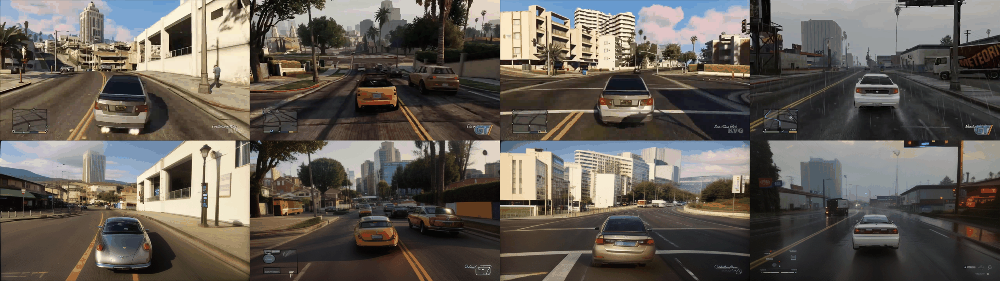

In [6]:
from diffusers.blip import blip_decoder

import os
import cv2
import torch
from diffusers import MotionAdapter, AnimateDiffVideoToVideoPipeline, DDIMScheduler
from diffusers.utils import export_to_gif
import imageio
from PIL import Image as PILImage
from IPython.display import display, Image
from diffusers.utils import export_to_gif, make_image_grid
import numpy as np
from torchvision import transforms
from torchvision.transforms.functional import InterpolationMode

device = "cuda:3"
torch.cuda.set_device(device)


def load_demo_image(image, image_size, device):
    w, h = image.size
    # display(raw_image.resize((w//5,h//5)))

    transform = transforms.Compose(
        [
            transforms.Resize((image_size, image_size), interpolation=InterpolationMode.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711)),
        ]
    )
    image = transform(image).unsqueeze(0).to(device)
    return image


def extract_frame(video_path):
    frames = []
    cap = cv2.VideoCapture(video_path)

    while True:
        ret, frame = cap.read()

        if not ret:
            break

        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame = PILImage.fromarray(frame)
        frames.append(frame)
    cap.release()
    return frames


# Load the motion adapter
adapter = MotionAdapter.from_pretrained("/data/noah/ckpt/pretrain_ckpt/StableDiffusion/animatediff_adapter").to(device)
# adapter = MotionAdapter.from_pretrained("/data/noah/ckpt/finetuning/ANI_AD/checkpoint-9000").to(device)

# load SD 1.5 based finetuned model
model_id = "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/rv"
pipe = AnimateDiffVideoToVideoPipeline.from_pretrained(model_id, motion_adapter=adapter, torch_dtype=torch.float16)
scheduler = DDIMScheduler.from_pretrained(
    model_id,
    beta_schedule="linear",
    subfolder="scheduler",
    clip_sample=False,
    timestep_spacing="linspace",
    steps_offset=1,
)
pipe.scheduler = scheduler

# enable memory savings
pipe.enable_vae_slicing()
pipe.enable_vae_tiling()

# generation quality option
pipe.enable_freeu(s1=0.9, s2=0.2, b1=1.2, b2=1.4)
freeinit_filters = [
    dict(
        method="gaussian",
        spatial_stop_frequency=0.25,
        temporal_stop_frequency=0.25,
    ),
    dict(
        method="butterworth",
        order=4,
        spatial_stop_frequency=0.25,
        temporal_stop_frequency=0.25,
    ),
    dict(
        method="butterworth",
        order=4,
        spatial_stop_frequency=0.4,
        temporal_stop_frequency=0.4,
    ),
    dict(
        method="butterworth",
        order=4,
        spatial_stop_frequency=0.25,
        temporal_stop_frequency=0.25,
        use_fast_sampling=True,
    ),
]

# filter selection
filter = freeinit_filters[1]
# pipe.enable_free_init(**filter, generator=torch.Generator().manual_seed(42))
pipe = pipe.to(device)

model = blip_decoder(
    pretrained="/data/noah/ckpt/pretrain_ckpt/BLIP/model_large_caption.pth", image_size=512, vit="large"
)
model.eval()
model = model.to(device)

video_paths = "/data/noah/inference/simulation/incabin_sample/reference_vid"
video_out_path = "/data/noah/inference/simulation/incabin_sample/out/grid.gif"

result_images = []
input_images = []
sample_cnt = 16

for video_path in os.listdir(video_paths):
    video_path = os.path.join(video_paths, video_path)
    images = extract_frame(video_path)
    images = images[:sample_cnt]

    blip_image = load_demo_image(image=images[0], image_size=512, device=device)
    with torch.no_grad():
        caption = model.generate(blip_image, sample=True, top_p=0.9, max_length=20, min_length=5)[0]
        print(caption)

    prompt = "{}, outdoor, best quality, extremely detailed, clearness, naturalness, film grain, crystal clear, photo with color, actuality".format(
        caption
    )
    negative_prompt = "cartoon, anime, painting, disfigured, immature, blur, picture, 3D, render, semi-realistic, drawing, poorly drawn, bad anatomy, wrong anatomy, gray scale, worst quality, low quality, sketch"
    frames = pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        video=[images],
        height=512,  # 512
        width=768,  # 768
        guidance_scale=7.5,  # 7
        strength=0.65,  # 0.7
        num_inference_steps=50,  # 20
        generator=torch.Generator().manual_seed(42),
    ).frames[0]

    new_w, new_h = images[0].width, images[0].height
    for idx, f in enumerate(frames):
        frames[idx] = f.resize((new_w, new_h))

    input_images.append(images)
    result_images.append(frames)

grids = []
result_images = np.array(result_images).astype("uint8")
input_images = np.array(input_images).astype("uint8")
num_video = len(os.listdir(video_paths))

for idx in range(sample_cnt):
    sub_result_images = [PILImage.fromarray(r) for r in result_images[:, idx, ...]]
    sub_input_images = [PILImage.fromarray(i) for i in input_images[:, idx, ...]]

    image_grid = make_image_grid(sub_input_images, rows=1, cols=num_video)
    result_grid = make_image_grid(sub_result_images, rows=1, cols=num_video)
    grid = make_image_grid([image_grid, result_grid], rows=2, cols=1)
    grids.append(grid.resize((grid.width // 2, grid.height // 2)))

export_to_gif(grids, video_out_path)
display(Image(video_out_path))

### Stable Diffusion ControlNet Pipeline


In [ ]:
import os
import cv2
import torch
from diffusers import MotionAdapter, StableDiffusionControlNetPipeline, DDIMScheduler, ControlNetModel
from diffusers.utils import export_to_gif, make_image_grid
from PIL import Image as PILImage

# from IPython.display import display, Image
from controlnet_aux import CannyDetector
from transformers import CLIPVisionModelWithProjection, CLIPImageProcessor
from torchvision import transforms
from torchvision.transforms.functional import InterpolationMode
from tqdm import tqdm
from diffusers.blip import blip_decoder


def load_demo_image(image_path, image_size, device):
    raw_image = PILImage.open(image_path).convert("RGB")

    w, h = raw_image.size
    # display(raw_image.resize((w//5,h//5)))

    transform = transforms.Compose(
        [
            transforms.Resize((image_size, image_size), interpolation=InterpolationMode.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711)),
        ]
    )
    image = transform(raw_image).unsqueeze(0).to(device)
    return image


device = "cuda:2"
torch.cuda.set_device(device)

model = blip_decoder(
    pretrained="/data/noah/ckpt/pretrain_ckpt/BLIP/model_large_caption.pth", image_size=512, vit="large"
)
model.eval()
model = model.to(device)

canny = CannyDetector()

# Load the motion adapter
feature_extractor = CLIPImageProcessor()
image_encoder = CLIPVisionModelWithProjection.from_pretrained("openai/clip-vit-large-patch14")
model_id = "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/rv"
lora_id = "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/lora_detail"
lora_name = "add_detail.safetensors"

controlnet = ControlNetModel.from_pretrained("/data/noah/ckpt/finetuning/Control_SD_AD", torch_dtype=torch.float16).to(
    device
)
pipe = StableDiffusionControlNetPipeline.from_pretrained(
    model_id,
    controlnet=controlnet,
    image_encoder=image_encoder,
    feature_extractor=feature_extractor,
    torch_dtype=torch.float16,
)
pipe.enable_freeu(s1=0.9, s2=0.2, b1=1.2, b2=1.4)
pipe.load_lora_weights(lora_id, weight_name=lora_name)
# pipe.load_ip_adapter(
#     "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/ip-adapter",
#     subfolder="models",
#     weight_name="ip-adapter_sd15.bin",
# )
pipe = pipe.to(device)

image_paths = "/data/noah/inference/simulation/incabin_sample/reference_img"

from diffusers.utils import load_image

result_images = []
input_images = []
control_images = []

for image_path in os.listdir(image_paths):
    image_path = os.path.join(image_paths, image_path)
    blip_image = load_demo_image(image_path=image_path, image_size=512, device=device)
    with torch.no_grad():
        caption = model.generate(blip_image, sample=True, top_p=0.9, max_length=20, min_length=5)[0]
        print(caption)
    image = load_image(image_path).convert("RGB")
    control_image = canny(
        image, detect_resolution=image.height, image_resolution=image.height, low_threshold=75, high_threshold=150
    )

    input_images.append(image)
    control_images.append(control_image)

    prompt = "{}, clear weather, outdoor, best quality, extremely detailed, clearness, naturalness, film grain, crystal clear, photo with color, actuality, <lora:add-detail:1>".format(
        caption
    )
    negative_prompt = "cartoon, anime, painting, disfigured, immature, blur, picture, 3D, render, semi-realistic, drawing, poorly drawn, bad anatomy, wrong anatomy, gray scale, worst quality, low quality, sketch"

    result_image = pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        image=control_image,
        height=512,  # 512
        width=768,  # 768
        guidance_scale=6.5,  # 7
        num_inference_steps=40,  # 20
        controlnet_conditioning_scale=0.7,
        # ip_adapter_image=image,
        generator=torch.Generator().manual_seed(42),
    ).images[0]

    new_w, new_h = control_image.width, control_image.height
    result_image = result_image.resize((new_w, new_h))
    result_images.append(result_image)

image_grid = make_image_grid(input_images, rows=1, cols=len(input_images))
control_grid = make_image_grid(control_images, rows=1, cols=len(input_images))
result_grid = make_image_grid(result_images, rows=1, cols=len(input_images))
result_grid = make_image_grid([image_grid, control_grid, result_grid], rows=3, cols=1)
display(result_grid)

### Animate Diff ControlNet Pipeline


reshape position embedding from 576 to 1024
load checkpoint from /data/noah/ckpt/pretrain_ckpt/BLIP/model_large_caption.pth


The config attributes {'motion_activation_fn': 'geglu', 'motion_attention_bias': False, 'motion_cross_attention_dim': None} were passed to MotionAdapter, but are not expected and will be ignored. Please verify your config.json configuration file.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

The config attributes {'center_input_sample': False, 'flip_sin_to_cos': True, 'freq_shift': 0, 'mid_block_type': 'UNetMidBlock2DCrossAttn', 'only_cross_attention': False, 'attention_head_dim': 8, 'dual_cross_attention': False, 'class_embed_type': None, 'addition_embed_type': None, 'num_class_embeds': None, 'upcast_attention': False, 'resnet_time_scale_shift': 'default', 'resnet_skip_time_act': False, 'resnet_out_scale_factor': 1.0, 'time_embedding_type': 'positional', 'time_embedding_dim': None, 'time_embedding_act_fn': None, 'timestep_post_act': None, 'time_cond_proj_dim': None, 'conv_in_kernel': 3, 'conv_out_kernel': 3, 'projection_class_embeddings_input_dim': None, 'class_embeddings_concat': False, 'mid_block_only_cross_attention': None, 'cross_attention_norm': None, 'addition_embed_type_num_heads': 64} were passed to UNetMotionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


a car driving down the middle of a street


  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

there is a yellow car in the street


  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

the screenshot of the car in need of driving


  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

the car is driving through a city street in grand theft


  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

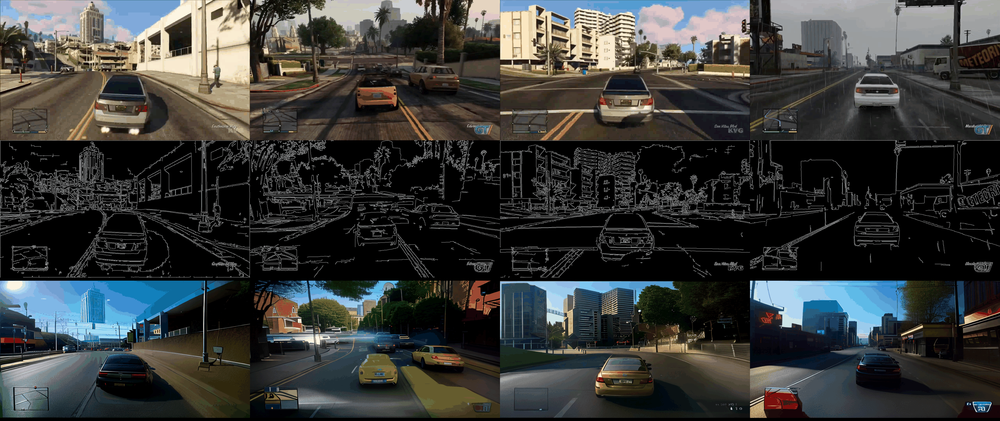

In [4]:
import os
import cv2
import torch
import numpy as np
from diffusers import AutoencoderKL, ControlNetModel, MotionAdapter
from diffusers.pipelines import AnimateDiffControlNetPipeline
from diffusers.schedulers import DDIMScheduler
from transformers import CLIPVisionModelWithProjection, CLIPImageProcessor
from PIL import Image as PILImage
from controlnet_aux import CannyDetector
from diffusers.utils import export_to_gif, make_image_grid
from IPython.display import display, Image
from diffusers.blip import blip_decoder
from torchvision import transforms
from torchvision.transforms.functional import InterpolationMode

device = "cuda:3"
torch.cuda.set_device(device)
generator = torch.Generator().manual_seed(100)


def extract_frame(video_path):
    images = []
    frames = []
    cap = cv2.VideoCapture(video_path)
    canny = CannyDetector()

    while True:
        ret, frame = cap.read()

        if not ret:
            break

        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame = PILImage.fromarray(frame)

        images.append(frame)

        frames.append(
            canny(
                frame,
                detect_resolution=frame.height,
                image_resolution=frame.height,
                low_threshold=50,
                high_threshold=150,
            )
        )
    cap.release()
    return images, frames


def load_demo_image(image, image_size, device):
    w, h = image.size
    # display(raw_image.resize((w//5,h//5)))

    transform = transforms.Compose(
        [
            transforms.Resize((image_size, image_size), interpolation=InterpolationMode.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711)),
        ]
    )
    image = transform(image).unsqueeze(0).to(device)
    return image


from diffusers.blip import blip_decoder

model = blip_decoder(
    pretrained="/data/noah/ckpt/pretrain_ckpt/BLIP/model_large_caption.pth", image_size=512, vit="large"
)
model.eval()
model = model.to(device)

adapter = MotionAdapter.from_pretrained("/data/noah/ckpt/pretrain_ckpt/StableDiffusion/animatediff_adapter").to(device)
# adapter = MotionAdapter.from_pretrained("/data/noah/ckpt/finetuning/ANI_AD/checkpoint-9000").to(device)

controlnet = ControlNetModel.from_pretrained(
    "/data/noah/ckpt/finetuning/Control_Canny_SD_AD", torch_dtype=torch.float16
).to(device)

model_id = "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/rv"
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to(device)
# vae = AutoencoderKL.from_pretrained(os.path.join(model_id, 'vae'), torch_dtype=torch.float16).to(device)

image_encoder = CLIPVisionModelWithProjection.from_pretrained("openai/clip-vit-large-patch14")
feature_extractor = CLIPImageProcessor()
pipe = AnimateDiffControlNetPipeline.from_pretrained(
    model_id,
    motion_adapter=adapter,
    controlnet=controlnet,
    vae=vae,
    image_encoder=image_encoder,
    feature_extractor=feature_extractor,
)
scheduler = DDIMScheduler.from_pretrained(
    model_id,
    beta_schedule="linear",
    subfolder="scheduler",
    clip_sample=False,
    timestep_spacing="linspace",
    steps_offset=1,
)
pipe.scheduler = scheduler

freeinit_filters = [
    dict(
        method="gaussian",
        spatial_stop_frequency=0.25,
        temporal_stop_frequency=0.25,
    ),
    dict(
        method="butterworth",
        order=4,
        spatial_stop_frequency=0.25,
        temporal_stop_frequency=0.25,
    ),
    dict(
        method="butterworth",
        order=4,
        spatial_stop_frequency=0.4,
        temporal_stop_frequency=0.4,
    ),
    dict(
        method="butterworth",
        order=4,
        spatial_stop_frequency=0.25,
        temporal_stop_frequency=0.25,
        use_fast_sampling=True,
    ),
]

# filter selection
filter = freeinit_filters[1]
pipe.enable_free_init(**filter, generator=generator)
pipe.enable_vae_slicing()
pipe.enable_vae_tiling()
pipe.enable_freeu(s1=0.9, s2=0.2, b1=1.2, b2=1.4)

# lora_id = "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/lora_detail"
# lora_name = "add_detail.safetensors"
# pipe.load_lora_weights(lora_id, weight_name=lora_name)
pipe = pipe.to(device=device, dtype=torch.float16)

video_paths = "/data/noah/inference/simulation/incabin_sample/reference_vid"
video_out_path = "/data/noah/inference/simulation/incabin_sample/out/grid.gif"

result_images = []
input_images = []
control_images = []
sample_cnt = 16

for video_path in os.listdir(video_paths):
    video_path = os.path.join(video_paths, video_path)
    images, conditioning_frames = extract_frame(video_path)
    images = images[:sample_cnt]
    conditioning_frames = conditioning_frames[:sample_cnt]

    blip_image = load_demo_image(image=images[0], image_size=512, device=device)
    with torch.no_grad():
        caption = model.generate(blip_image, sample=True, top_p=0.9, max_length=20, min_length=5)[0]
        print(caption)

    prompt = "{}, outdoor, best quality, extremely detailed, clearness, naturalness, film grain, crystal clear, photo with color, actuality".format(
        caption
    )
    negative_prompt = "cartoon, anime, painting, disfigured, immature, blur, picture, 3D, render, semi-realistic, drawing, poorly drawn, bad anatomy, wrong anatomy, gray scale, worst quality, low quality, sketch"
    frames = pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        num_frames=len(conditioning_frames),
        height=512,
        width=768,
        guidance_scale=6.0,
        controlnet_conditioning_scale=0.65,
        conditioning_frames=conditioning_frames,
        num_inference_steps=20,
        generator=generator,
    ).frames[0]

    new_w, new_h = conditioning_frames[0].width, conditioning_frames[0].height
    for idx, f in enumerate(frames):
        frames[idx] = f.resize((new_w, new_h))

    input_images.append(images)
    control_images.append(conditioning_frames)
    result_images.append(frames)

grids = []
result_images = np.array(result_images).astype("uint8")
input_images = np.array(input_images).astype("uint8")
control_images = np.array(control_images).astype("uint8")
num_video = len(os.listdir(video_paths))

for idx in range(sample_cnt):
    sub_result_images = [PILImage.fromarray(r) for r in result_images[:, idx, ...]]
    sub_input_images = [PILImage.fromarray(i) for i in input_images[:, idx, ...]]
    sub_control_images = [PILImage.fromarray(c) for c in control_images[:, idx, ...]]

    image_grid = make_image_grid(sub_input_images, rows=1, cols=num_video)
    condition_grid = make_image_grid(sub_control_images, rows=1, cols=num_video)
    result_grid = make_image_grid(sub_result_images, rows=1, cols=num_video)
    grid = make_image_grid([image_grid, condition_grid, result_grid], rows=3, cols=1)
    grids.append(grid.resize((grid.width // 2, grid.height // 2)))

export_to_gif(grids, video_out_path)
display(Image(video_out_path))

# AnimateDiff Multi-ControlNet


In [ ]:
import os
import cv2
import torch
import numpy as np
from diffusers import AutoencoderKL, ControlNetModel, MotionAdapter
from diffusers.pipelines import AnimateDiffControlNetPipeline
from diffusers.schedulers import DDIMScheduler
from transformers import CLIPVisionModelWithProjection, CLIPImageProcessor
from PIL import Image as PILImage
from controlnet_aux.processor import Processor
from diffusers.utils import export_to_gif, make_image_grid
from IPython.display import display, Image
from diffusers.blip import blip_decoder
from torchvision import transforms
from torchvision.transforms.functional import InterpolationMode

device = "cuda:2"
torch.cuda.set_device(device)
generator = torch.Generator().manual_seed(100)


def extract_frame(video_path):
    images = []
    cap = cv2.VideoCapture(video_path)

    while True:
        ret, frame = cap.read()

        if not ret:
            break

        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame = PILImage.fromarray(frame)

        images.append(frame)

    cap.release()
    return images


def load_demo_image(image, image_size, device):
    w, h = image.size
    # display(raw_image.resize((w//5,h//5)))

    transform = transforms.Compose(
        [
            transforms.Resize((image_size, image_size), interpolation=InterpolationMode.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711)),
        ]
    )
    image = transform(image).unsqueeze(0).to(device)
    return image


model = blip_decoder(
    pretrained="/data/noah/ckpt/pretrain_ckpt/BLIP/model_large_caption.pth", image_size=512, vit="large"
)
model.eval()
model = model.to(device)

edge = Processor("canny")
depth = Processor("depth_midas")

adapter = MotionAdapter.from_pretrained("/data/noah/ckpt/pretrain_ckpt/StableDiffusion/animatediff_adapter").to(device)
# adapter = MotionAdapter.from_pretrained("/data/noah/ckpt/finetuning/ANI_AD/checkpoint-14000").to(device)

controlnet = ControlNetModel.from_pretrained(
    "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/controlnet_canny", torch_dtype=torch.float16
).to(device)
controlnet_2 = ControlNetModel.from_pretrained("lllyasviel/control_v11f1p_sd15_depth", torch_dtype=torch.float16).to(
    device
)
# controlnet = ControlNetModel.from_pretrained("/data/noah/ckpt/finetuning/Control_SD_AD", torch_dtype=torch.float16).to(
#     device
# )

model_id = "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/rv"
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to(device)
# vae = AutoencoderKL.from_pretrained(os.path.join(model_id, 'vae'), torch_dtype=torch.float16).to(device)

image_encoder = CLIPVisionModelWithProjection.from_pretrained("openai/clip-vit-large-patch14")
feature_extractor = CLIPImageProcessor()
pipe = AnimateDiffControlNetPipeline.from_pretrained(
    model_id,
    motion_adapter=adapter,
    controlnet=[controlnet, controlnet_2],
    vae=vae,
    image_encoder=image_encoder,
    feature_extractor=feature_extractor,
)
scheduler = DDIMScheduler.from_pretrained(
    model_id,
    beta_schedule="linear",
    subfolder="scheduler",
    clip_sample=False,
    timestep_spacing="linspace",
    steps_offset=1,
)
pipe.scheduler = scheduler

freeinit_filters = [
    dict(
        method="gaussian",
        spatial_stop_frequency=0.25,
        temporal_stop_frequency=0.25,
    ),
    dict(
        method="butterworth",
        order=4,
        spatial_stop_frequency=0.25,
        temporal_stop_frequency=0.25,
    ),
    dict(
        method="butterworth",
        order=4,
        spatial_stop_frequency=0.4,
        temporal_stop_frequency=0.4,
    ),
    dict(
        method="butterworth",
        order=4,
        spatial_stop_frequency=0.25,
        temporal_stop_frequency=0.25,
        use_fast_sampling=True,
    ),
]

# filter selection
filter = freeinit_filters[1]
# pipe.enable_free_init(**filter, generator=generator)
pipe.enable_vae_slicing()
pipe.enable_vae_tiling()
# pipe.enable_freeu(s1=0.9, s2=0.2, b1=1.2, b2=1.4)

# lora_id = "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/lora_detail"
# lora_name = "add_detail.safetensors"
# pipe.load_lora_weights(lora_id, weight_name=lora_name)
pipe = pipe.to(device=device, dtype=torch.float16)

video_paths = "/data/noah/inference/simulation/incabin_sample/reference_vid"
video_out_path = "/data/noah/inference/simulation/incabin_sample/out/grid.gif"

result_images = []
input_images = []
edge_control_images = []
depth_control_images = []
sample_cnt = 16

for video_path in os.listdir(video_paths):
    video_path = os.path.join(video_paths, video_path)
    images = extract_frame(video_path)
    images = images[:sample_cnt]

    edge_control_frames = [edge(img) for img in images]
    depth_control_frames = [depth(img) for img in images]

    blip_image = load_demo_image(image=images[0], image_size=512, device=device)
    with torch.no_grad():
        caption = model.generate(blip_image, sample=True, top_p=0.9, max_length=20, min_length=5)[0]
        print(caption)

    prompt = "{}, outdoor, best quality, extremely detailed, clearness, naturalness, film grain, crystal clear, photo with color, actuality".format(
        caption
    )
    negative_prompt = "cartoon, anime, painting, disfigured, immature, blur, picture, 3D, render, semi-realistic, drawing, poorly drawn, bad anatomy, wrong anatomy, gray scale, worst quality, low quality, sketch"
    frames = pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        num_frames=len(edge_control_frames),
        height=512,
        width=768,
        guidance_scale=6.5,
        controlnet_conditioning_scale=0.7,
        conditioning_frames=[edge_control_frames, depth_control_frames],
        num_inference_steps=25,
        generator=generator,
    ).frames[0]

    new_w, new_h = edge_control_frames[0].width, edge_control_frames[0].height
    for idx, f in enumerate(frames):
        frames[idx] = f.resize((new_w, new_h))

    input_images.append(images)
    edge_control_images.append(edge_control_frames)
    depth_control_images.append(depth_control_frames)
    result_images.append(frames)

grids = []
result_images = np.array(result_images).astype("uint8")
input_images = np.array(input_images).astype("uint8")
edge_control_images = np.array(edge_control_images).astype("uint8")
depth_control_images = np.array(depth_control_images).astype("uint8")
num_video = len(os.listdir(video_paths))

for idx in range(sample_cnt):
    sub_result_images = [PILImage.fromarray(r) for r in result_images[:, idx, ...]]
    sub_input_images = [PILImage.fromarray(i) for i in input_images[:, idx, ...]]
    sub_edge_images = [PILImage.fromarray(c) for c in edge_control_images[:, idx, ...]]
    sub_depth_images = [PILImage.fromarray(c) for c in depth_control_images[:, idx, ...]]

    image_grid = make_image_grid(sub_input_images, rows=1, cols=num_video)
    condition_edge_grid = make_image_grid(sub_edge_images, rows=1, cols=num_video)
    condition_depth_grid = make_image_grid(sub_depth_images, rows=1, cols=num_video)
    result_grid = make_image_grid(sub_result_images, rows=1, cols=num_video)
    grid = make_image_grid([image_grid, condition_edge_grid, condition_depth_grid, result_grid], rows=4, cols=1)
    grids.append(grid.resize((grid.width // 2, grid.height // 2)))

export_to_gif(grids, video_out_path)
display(Image(video_out_path))

In [3]:
import os
from IPython.display import display, Image
from PIL import Image as PILImage
from diffusers.utils import export_to_gif, make_image_grid

path = "/data/noah/eval/src/real/3"

images = []

for _ in sorted(os.listdir(path)):
    images.append(PILImage.open(os.path.join(path, _)))

export_to_gif(images, "./real3.gif")

'./real3.gif'